<a href="https://www.kaggle.com/code/harshris21/face-generation-cgan-scratch?scriptVersionId=127210164" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:

!wget https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip
!unzip -q male_female_face_images.zip
     

--2023-04-25 17:46:49--  https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.9.18, 2620:100:601f:18::a27d:912
Connecting to www.dropbox.com (www.dropbox.com)|162.125.9.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/rbajpdlh7efkdo1/male_female_face_images.zip [following]
--2023-04-25 17:46:49--  https://www.dropbox.com/s/raw/rbajpdlh7efkdo1/male_female_face_images.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc3b0006e949534f90d00930230c.dl.dropboxusercontent.com/cd/0/inline/B61fvf8DsDFMarEuif9zv-J2EFdeaNwPIDs9Mj_Q97LmezsZq8Djc1ipv3u8-xfK2E0w9eeyqFxNQTBPfp7qqJ2bwSroKQTCnK3STFHT40KmlWkctQQ59DF44mDyxKZCKjXC4eDRA1k1WrJJBPXnFNcRg5OPfaNWmZMoZZtpdOfkRg/file# [following]
--2023-04-25 17:46:49--  https://uc3b0006e949534f90d00930230c.dl.dropboxusercontent.com/cd/0/inline/B61fvf8DsDFMarEuif9zv-J2EFdeaNwPIDs

In [3]:
!pip install torch_snippets 
from torch_snippets import *
device='cuda' if torch.cuda.is_available() else 'cpu'
from torchvision import transforms
from PIL import Image 
import torchvision
import torchvision.utils as vutils

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... - done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.0/60.0 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 59.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 201.9/201.9 kB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.8/98.8 kB 8.8 MB/s eta 0:00:00
  Created wheel for typing: filename=typing-3.7.4.3-py3-none-any.whl size=26323 sha256=83d0ea35ab7b8eb627ce1aaeb0eb4c1f08125b6e3f9f283fc5c955eae699130f
  Stored in directory: /root/.cache/pip/wheels/f9/53/6b/89c460c5ace18b7d98e8b73531a93e647e5cec1d7eaa794853
Successfully built typing


In [4]:
female_images=Glob(str(os.path.join(os.getcwd(),'females/*.jpg')))
male_images=Glob(str(os.path.join(os.getcwd(),'males/*.jpg')))

In [5]:
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

In [6]:
from tqdm import tqdm

In [7]:
os.makedirs(os.path.join(os.getcwd(),'cropped_faces_female'),exist_ok=True)
os.makedirs(os.path.join(os.getcwd(),'cropped_faces_male'),exist_ok=True)

female_dir=os.path.join(os.getcwd(),'cropped_faces_female')
male_dir=os.path.join(os.getcwd(),'cropped_faces_male')
print("**** Starting face detection and preparing new DataSet for Generation *****")
for i in tqdm(range(len(male_images))):
    img=read(male_images[i],1)
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    faces=face_cascade.detectMultiScale(gray,1.3,5)
    for (x,y,w,h) in faces:
        img2=img[y:y+h,x:x+w]
        cv2.imwrite(str(male_dir)+'/'+str(i)+'.jpg',cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))
        
print('***** Male Faces Completed , Starting with Female *******')
for i in tqdm(range(len(female_images))):
    img=read(female_images[i],1)
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    faces=face_cascade.detectMultiScale(gray,1.3,5)
    for (x,y,w,h) in faces:
        img2=img[y:y+h,x:x+w]
        cv2.imwrite(str(female_dir)+'/'+str(i)+'.jpg',cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))
        
        

**** Starting face detection and preparing new DataSet for Generation *****

100%|██████████| 13948/13948 [01:30<00:00, 154.20it/s]


***** Male Faces Completed , Starting with Female *******

100%|██████████| 14688/14688 [01:36<00:00, 152.41it/s]


In [8]:
transform=transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.ToTensor(),
   transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5,))
])

In [9]:
class Faces(Dataset):
    def __init__(self,folders):
        self.foldermale=folders[0]
        self.folderfemale=folders[1]
        self.images=sorted(Glob(self.folderfemale))+sorted(Glob(self.foldermale))
        
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self,idx):
        img_path=self.images[idx]
        img=Image.open(img_path)
        img=transform(img)
        gender=np.where('female' in str(img_path),1,0)
        return img,torch.tensor(gender).long()

In [10]:
ds = Faces(folders=['cropped_faces_female','cropped_faces_male'])
dataloader = DataLoader(ds, batch_size=64, shuffle=True, num_workers=8)
     

/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [11]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [12]:
class Discriminator(nn.Module):
    def __init__(self, emb_size=32):
        super(Discriminator, self).__init__()
        self.emb_size = 32
        self.label_embeddings = nn.Embedding(2, self.emb_size)
        self.model = nn.Sequential(
            nn.Conv2d(3,64,4,2,1,bias=False),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64,64*2,4,2,1,bias=False),
            nn.BatchNorm2d(64*2),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*2,64*4,4,2,1,bias=False),
            nn.BatchNorm2d(64*4),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*4,64*8,4,2,1,bias=False),
            nn.BatchNorm2d(64*8),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*8,64,4,2,1,bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Flatten()
        )
        self.model2 = nn.Sequential(
            nn.Linear(288,100),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Linear(100,1),
            nn.Sigmoid()
        )
        self.apply(weights_init)
    def forward(self, input, labels):
        x = self.model(input)
        y = self.label_embeddings(labels)
        input = torch.cat([x, y], 1)
        final_output = self.model2(input)
        return final_output

In [13]:
!pip install torch_summary
from torchsummary import summary
discriminator = Discriminator().to(device)
summary(discriminator,torch.zeros(32,3,64,64).to(device), torch.zeros(32).long().to(device));

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 256]                 --
|    └─Conv2d: 2-1                       [-1, 64, 32, 32]          3,072
|    └─LeakyReLU: 2-2                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-3                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-4                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-5                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-6                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-7                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-8                    [-1, 256, 8, 8]           --
|    └─Conv2d: 2-9                       [-1, 512, 4, 4]           2,097,152
|    └─BatchNorm2d: 2-10                 [-1, 512, 4, 4]           1,024
|    └─LeakyReLU: 2-11                   [-1, 512, 4, 4]           --
|    └─Conv2d: 2-12                      [-1, 64, 2, 2]     

In [14]:
class Generator(nn.Module):
    def __init__(self, emb_size=32):
        super(Generator,self).__init__()
        self.emb_size = emb_size
        self.label_embeddings = nn.Embedding(2, self.emb_size)
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100+self.emb_size,64*8,4,1,0,bias=False),
            nn.BatchNorm2d(64*8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*8,64*4,4,2,1,bias=False),
            nn.BatchNorm2d(64*4),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*4,64*2,4,2,1,bias=False),
            nn.BatchNorm2d(64*2),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*2,64,4,2,1,bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64,3,4,2,1,bias=False),
            nn.Tanh()
        )
        self.apply(weights_init)
    def forward(self,input_noise,labels):
        label_embeddings = self.label_embeddings(labels).view(len(labels), self.emb_size, 1, 1)
        input = torch.cat([input_noise, label_embeddings], 1)
        return self.model(input)

In [15]:
generator = Generator().to(device)
summary(generator,torch.zeros(32,100,1,1).to(device), torch.zeros(32).long().to(device));

Layer (type:depth-idx)                   Output Shape              Param #
├─Embedding: 1-1                         [-1, 32]                  64
├─Sequential: 1-2                        [-1, 3, 64, 64]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           1,081,344
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32

In [16]:

def noise(size):
    n = torch.randn(size, 100, 1, 1, device=device)
    return n.to(device)
     

In [17]:
def discriminator_train_step(real_data, real_labels, fake_data, fake_labels):
    d_optimizer.zero_grad()
    prediction_real = discriminator(real_data, real_labels)
    error_real = loss(prediction_real, torch.ones(len(real_data), 1).to(device))
    error_real.backward()
    prediction_fake = discriminator(fake_data, fake_labels)
    error_fake = loss(prediction_fake, torch.zeros(len(fake_data), 1).to(device))
    error_fake.backward()
    d_optimizer.step()    
    return error_real + error_fake

In [18]:
def generator_train_step(fake_data, fake_labels):
    g_optimizer.zero_grad()
    prediction = discriminator(fake_data, fake_labels)
    error = loss(prediction, torch.ones(len(fake_data), 1).to(device))
    error.backward()
    g_optimizer.step()
    return error

In [19]:
discriminator = Discriminator().to(device)
generator = Generator().to(device)
loss = nn.BCELoss()
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
fixed_noise = torch.randn(64, 100, 1, 1, device=device)
fixed_fake_labels = torch.LongTensor([0]*(len(fixed_noise)//2) + [1]*(len(fixed_noise)//2)).to(device)
loss = nn.BCELoss()
n_epochs = 25
img_list = []

EPOCH: 1.000  d_loss: 0.323  g_loss: 3.515  (40.47s - 971.19s remaining)


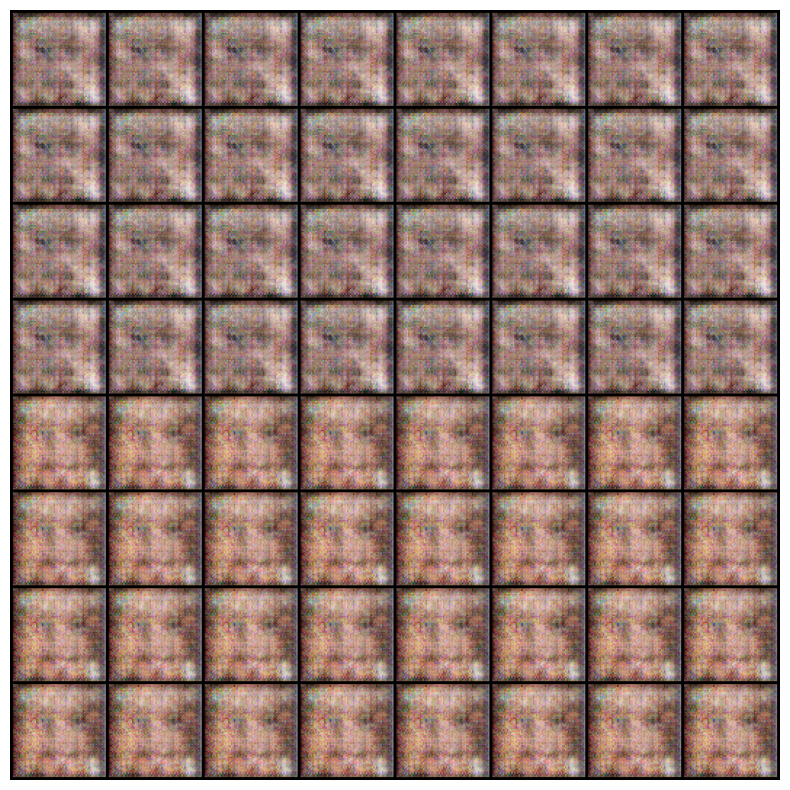

EPOCH: 2.000  d_loss: 0.501  g_loss: 4.674  (79.85s - 918.23s remaining)


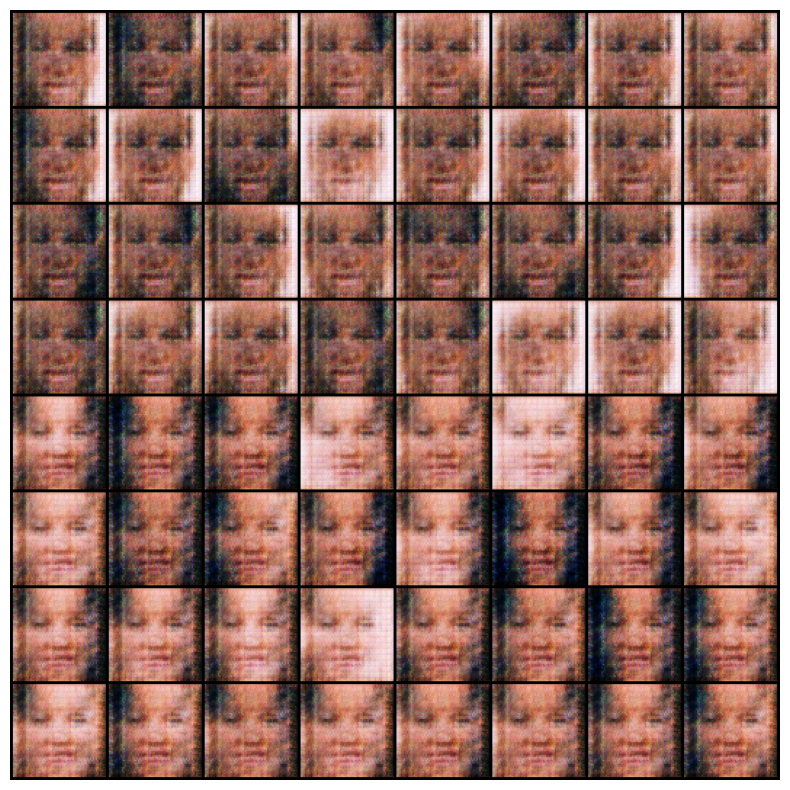

EPOCH: 3.000  d_loss: 0.429  g_loss: 5.341  (119.54s - 876.63s remaining)


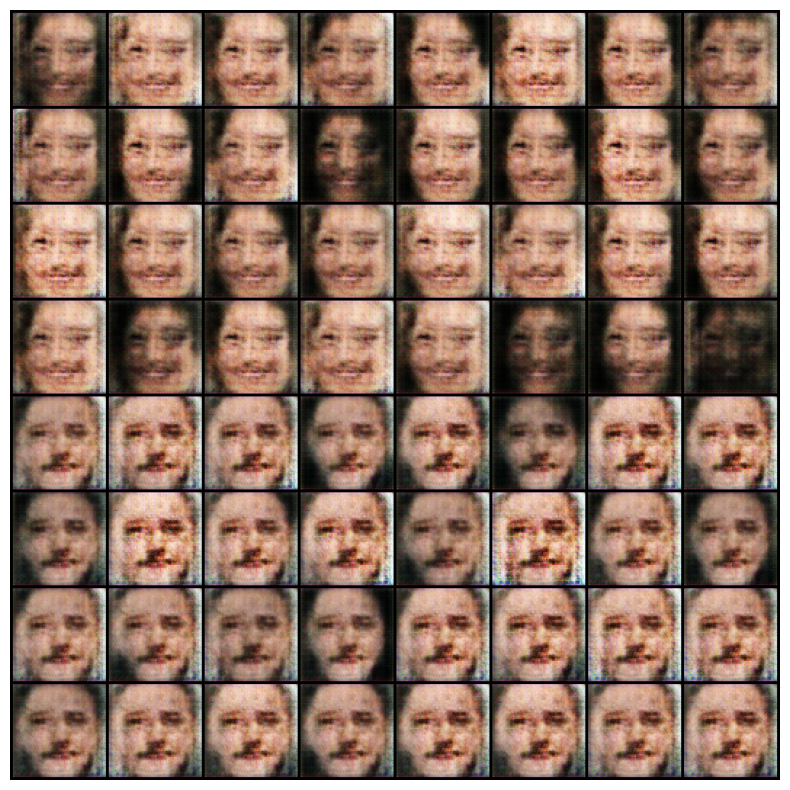

EPOCH: 4.000  d_loss: 0.358  g_loss: 5.853  (159.21s - 835.84s remaining)


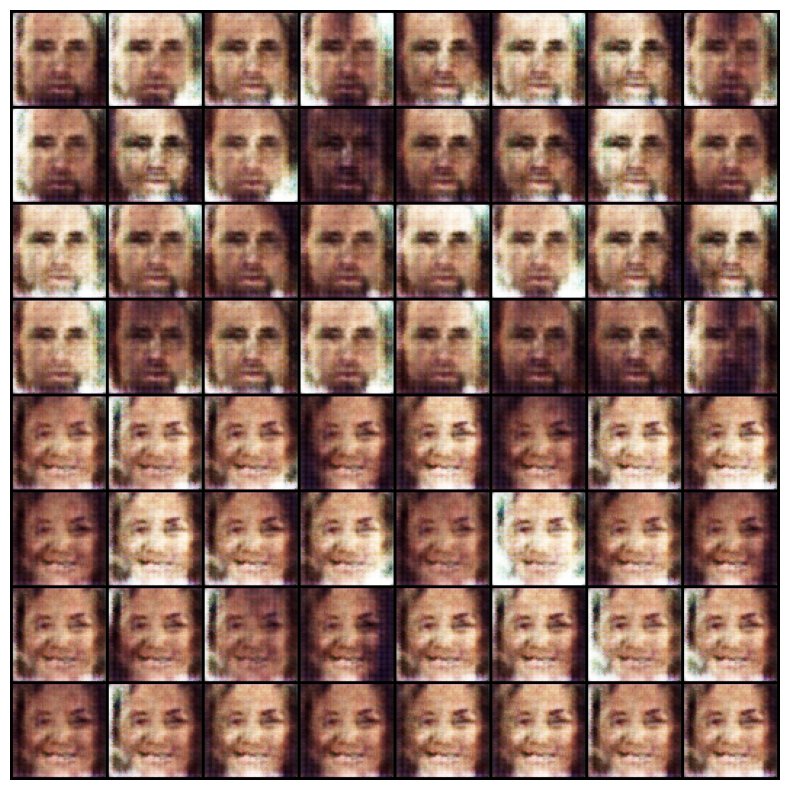

EPOCH: 5.000  d_loss: 0.360  g_loss: 6.383  (199.64s - 798.57s remaining)


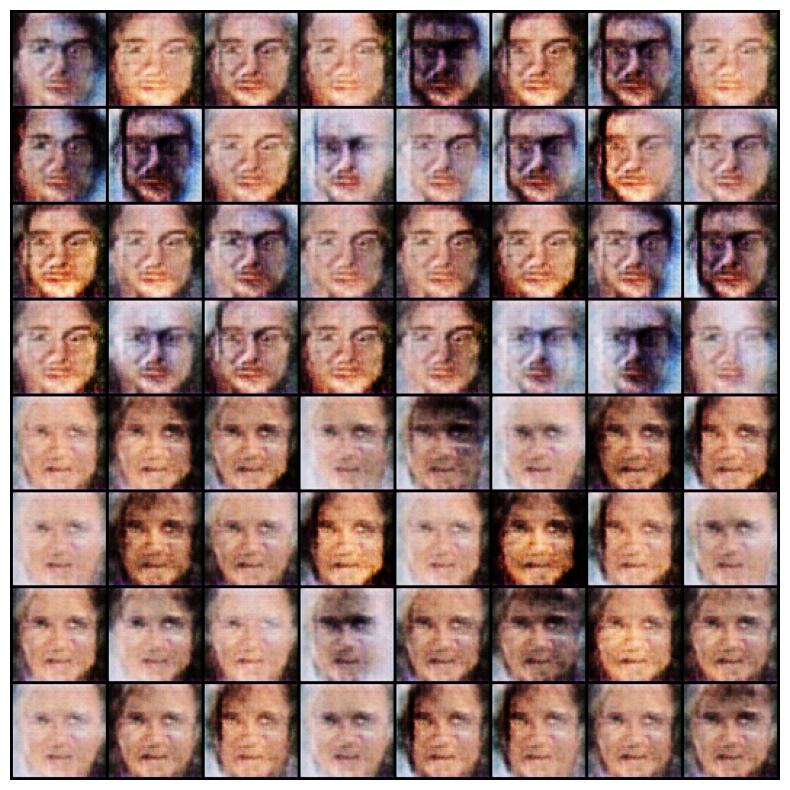

EPOCH: 6.000  d_loss: 0.366  g_loss: 6.330  (239.92s - 759.75s remaining)


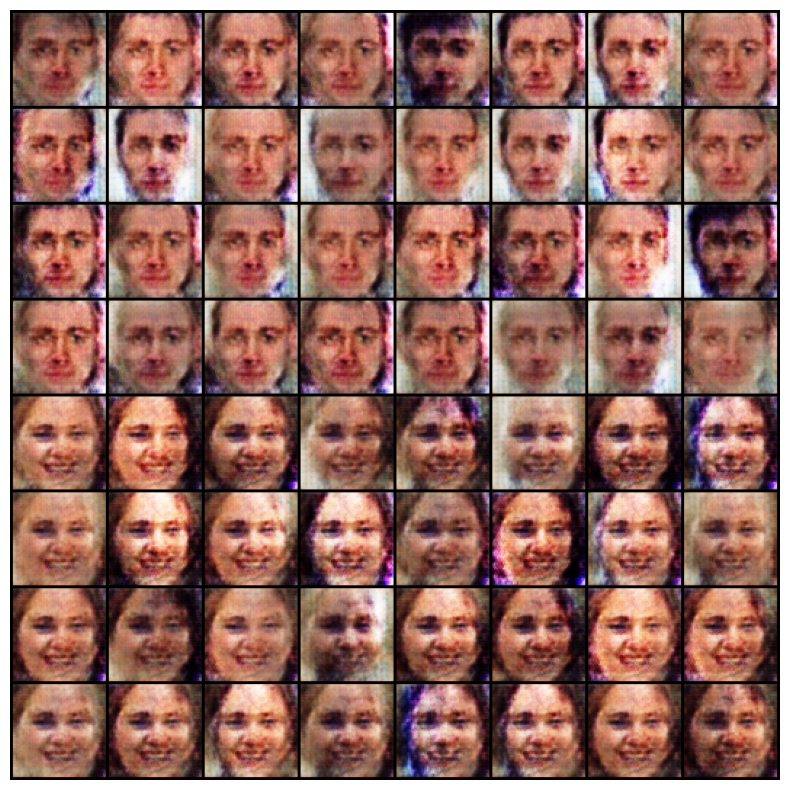

EPOCH: 7.000  d_loss: 0.373  g_loss: 6.237  (280.37s - 720.95s remaining)


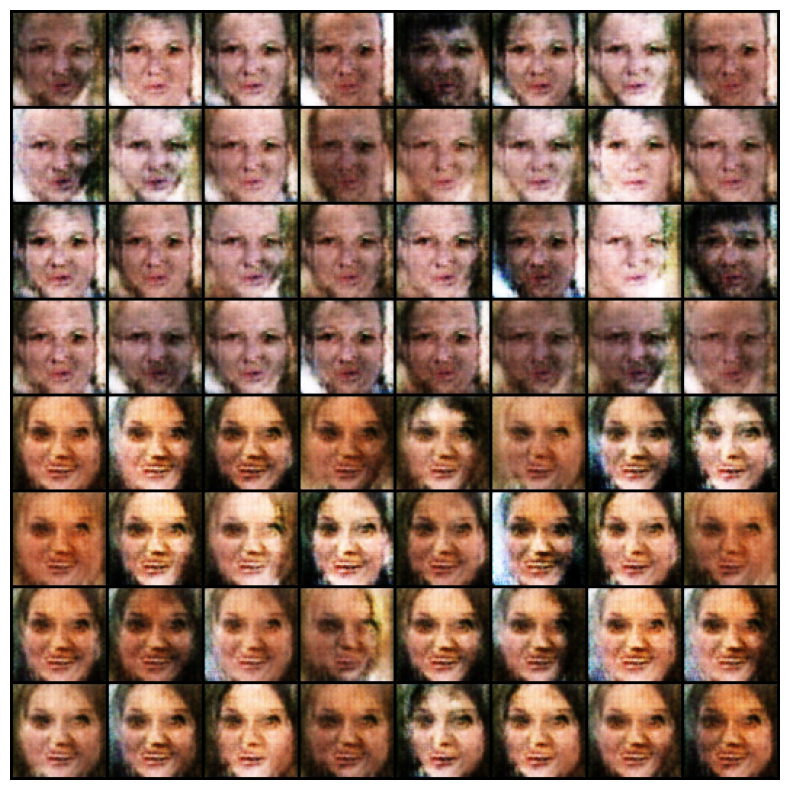

EPOCH: 8.000  d_loss: 0.360  g_loss: 6.517  (320.33s - 680.71s remaining)


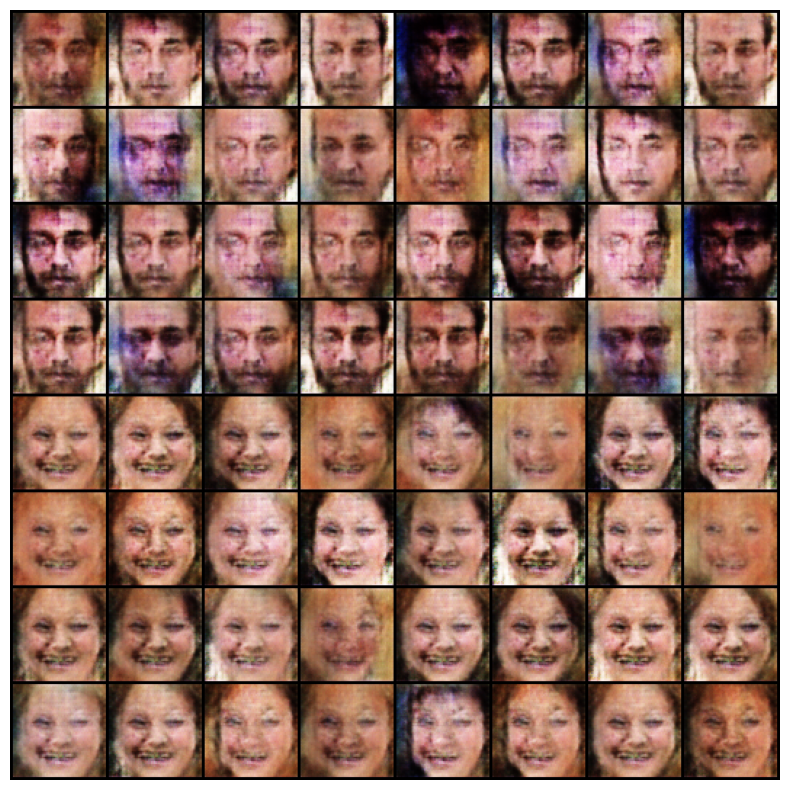

EPOCH: 9.000  d_loss: 0.326  g_loss: 6.668  (360.57s - 641.02s remaining)


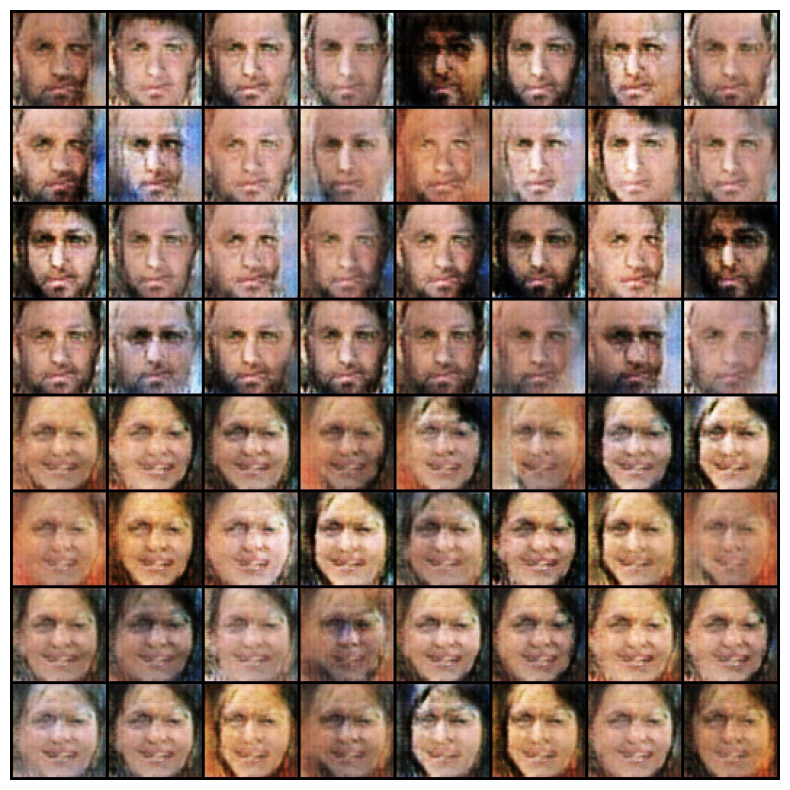

EPOCH: 10.000  d_loss: 0.377  g_loss: 6.384  (400.61s - 600.92s remaining)


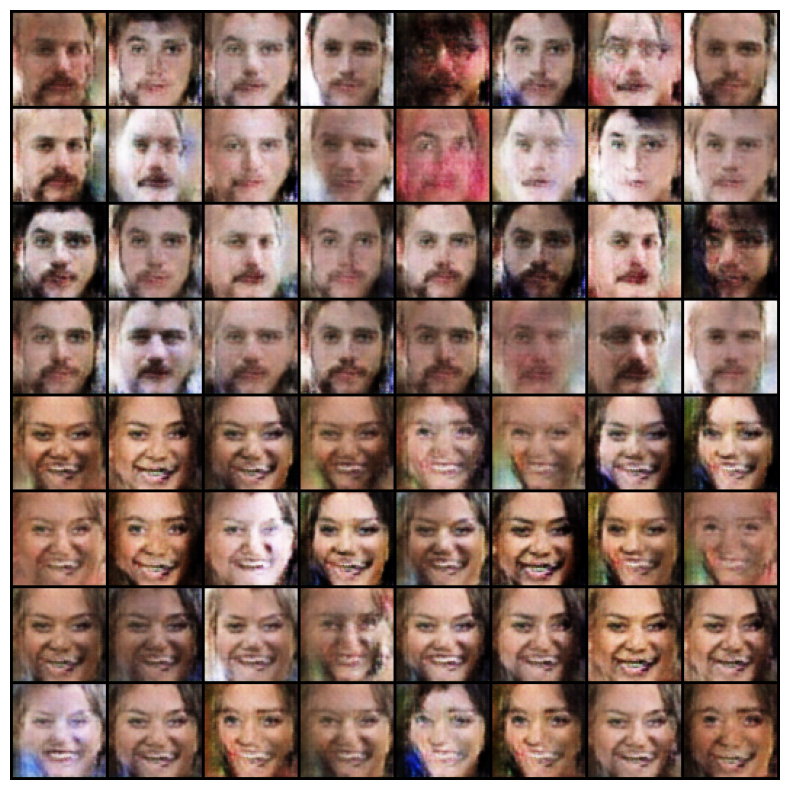

EPOCH: 11.000  d_loss: 0.403  g_loss: 5.901  (440.81s - 561.03s remaining)


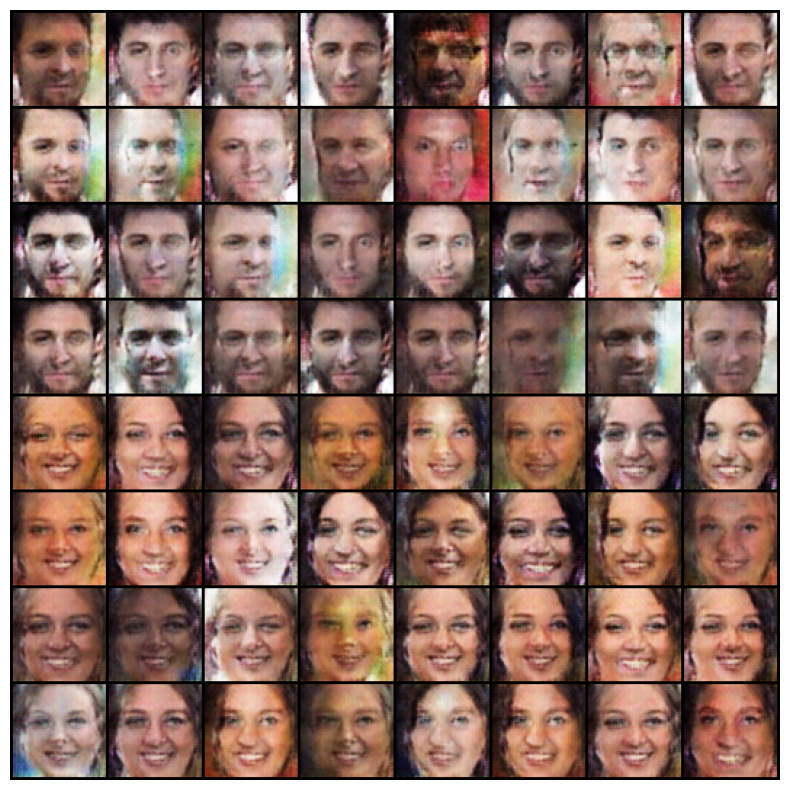

EPOCH: 12.000  d_loss: 0.393  g_loss: 5.948  (480.81s - 520.88s remaining)


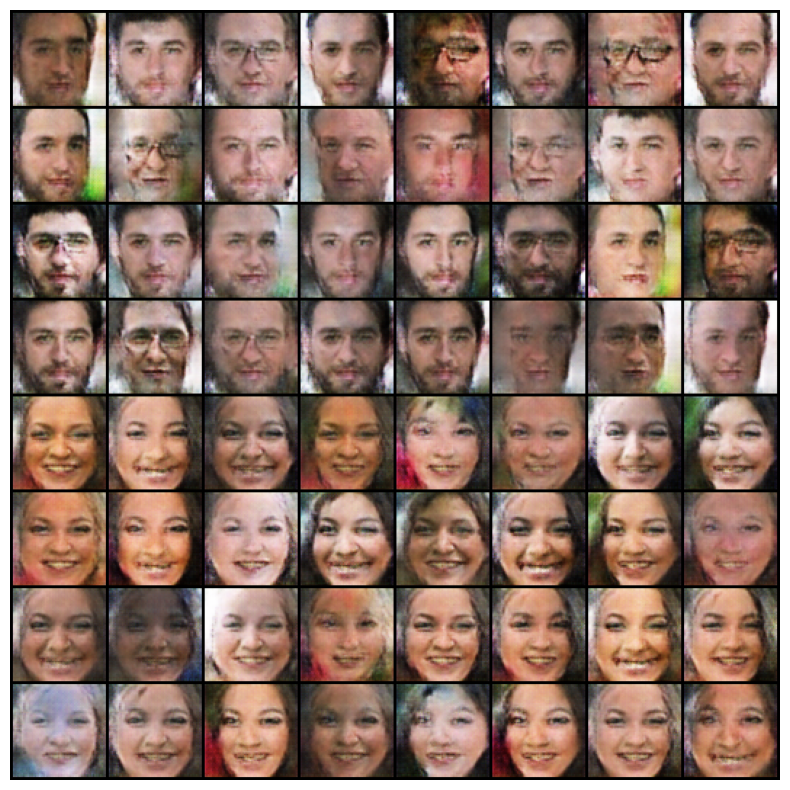

EPOCH: 13.000  d_loss: 0.396  g_loss: 5.546  (521.42s - 481.31s remaining)


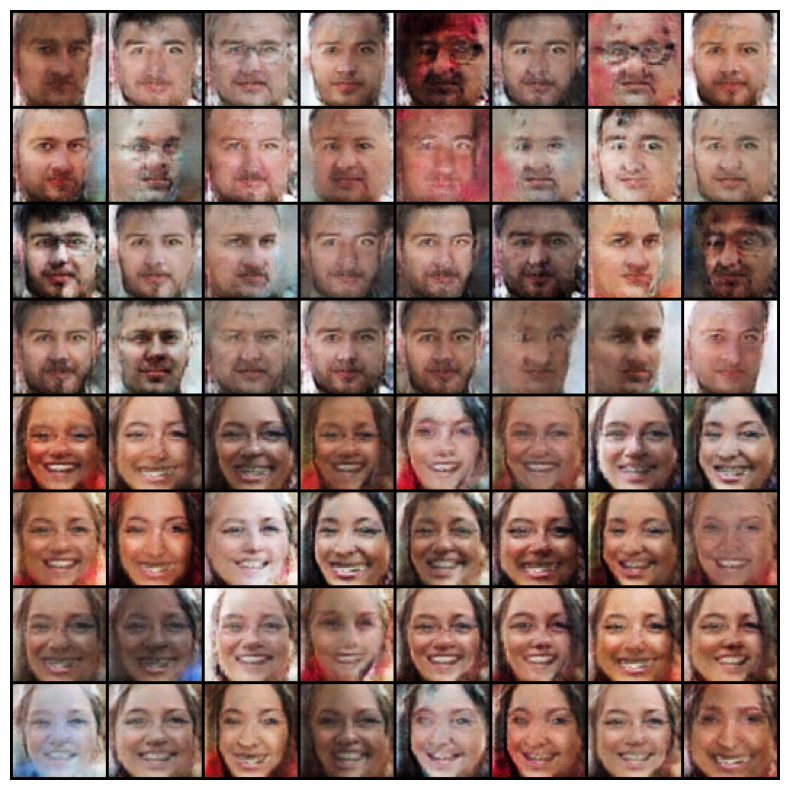

EPOCH: 14.000  d_loss: 0.387  g_loss: 5.699  (561.17s - 440.92s remaining)


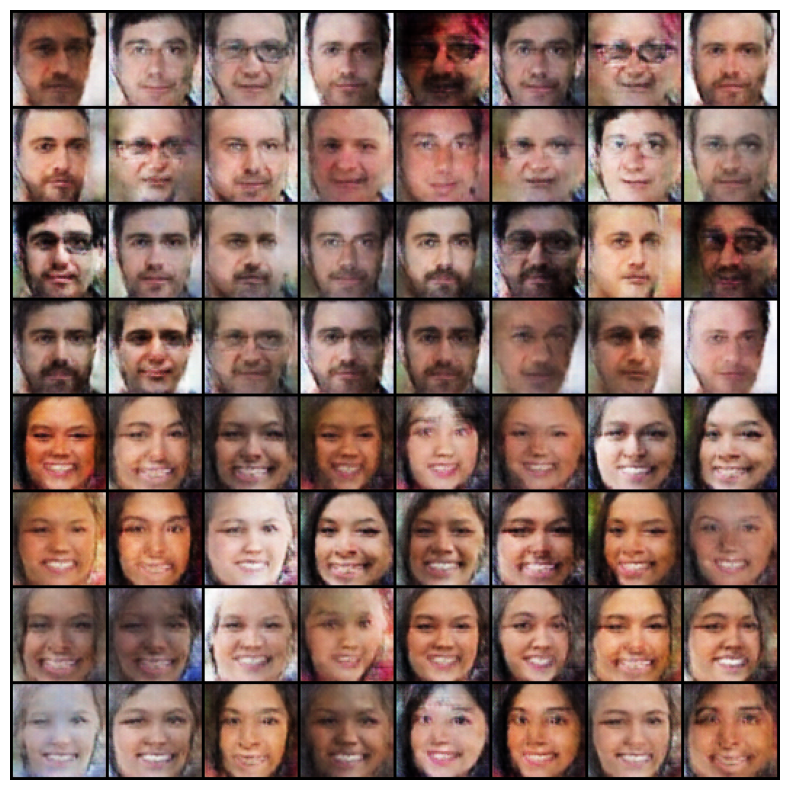

EPOCH: 15.000  d_loss: 0.399  g_loss: 5.481  (601.44s - 400.96s remaining)


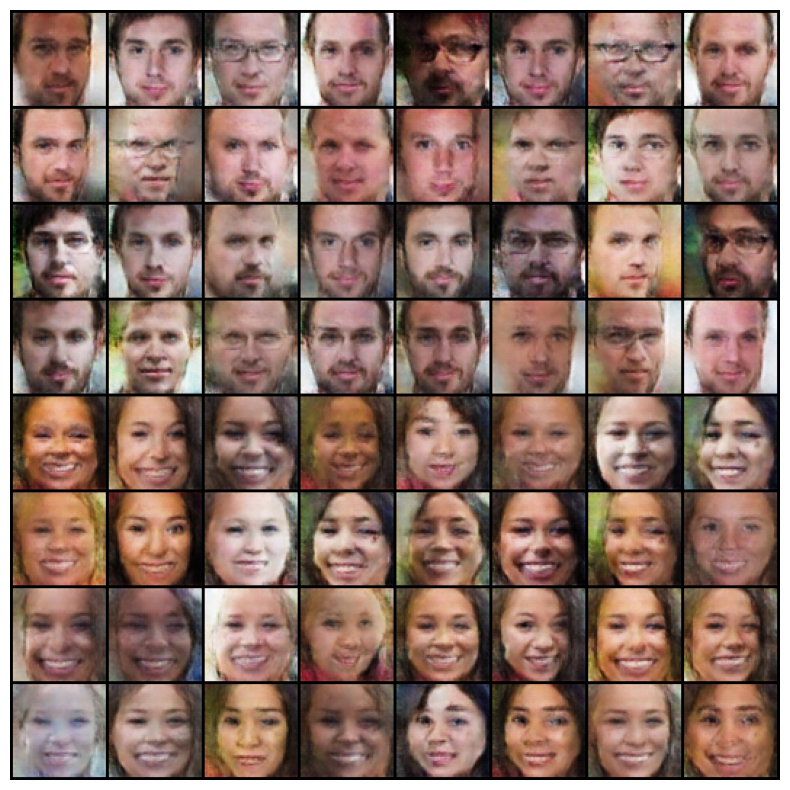

EPOCH: 16.000  d_loss: 0.399  g_loss: 5.180  (641.49s - 360.84s remaining)


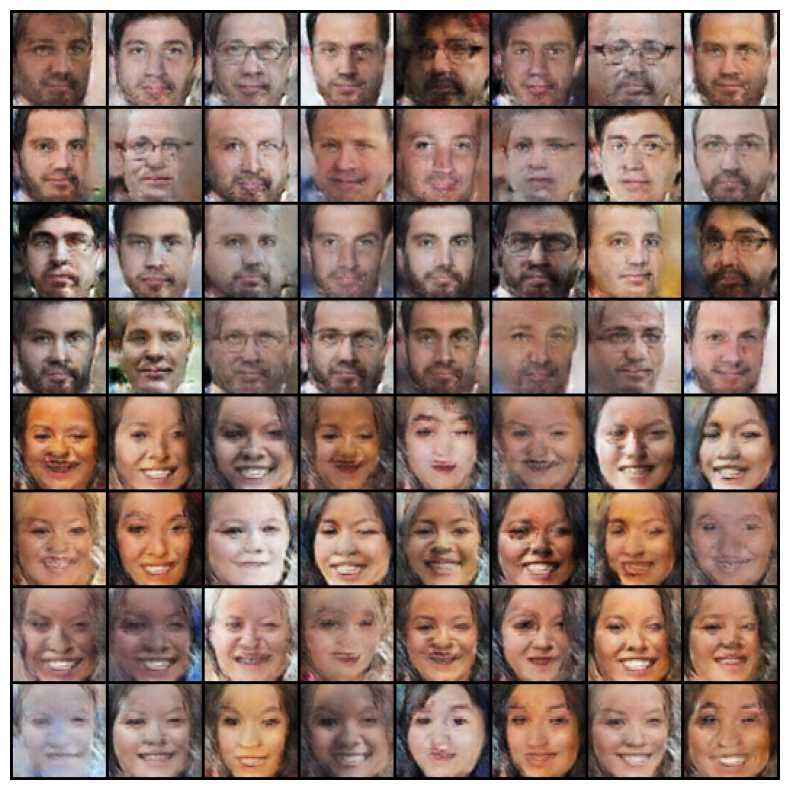

EPOCH: 17.000  d_loss: 0.433  g_loss: 5.048  (682.06s - 320.97s remaining)


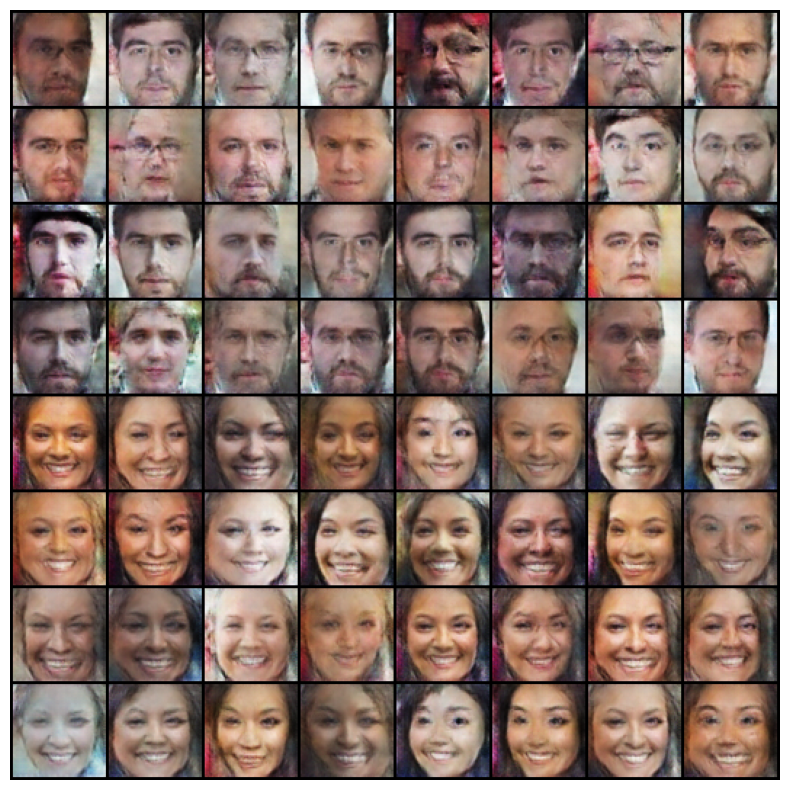

EPOCH: 18.000  d_loss: 0.397  g_loss: 4.941  (722.45s - 280.95s remaining)


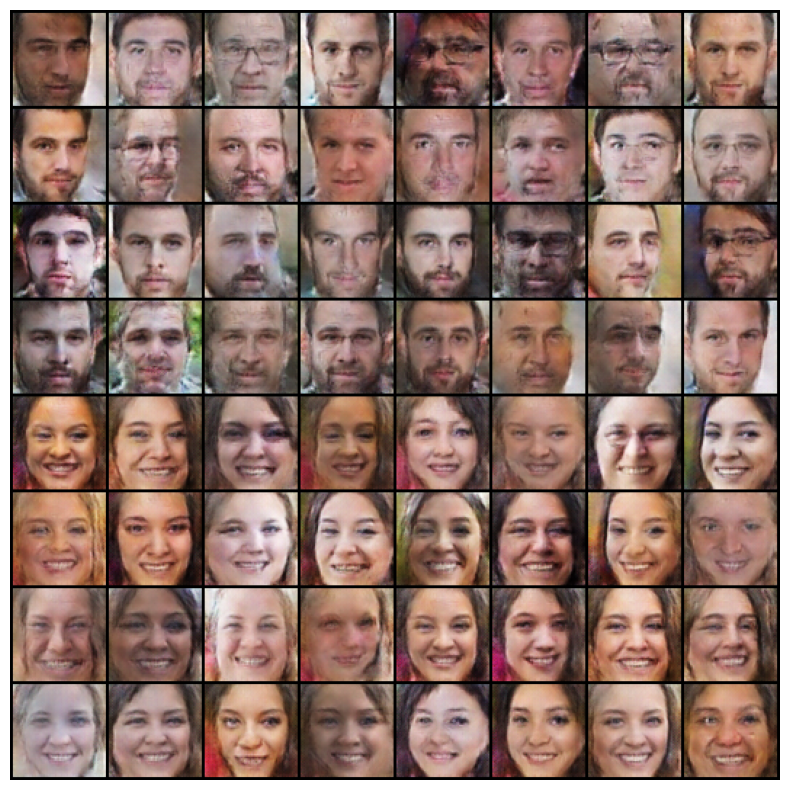

EPOCH: 19.000  d_loss: 0.412  g_loss: 4.853  (762.31s - 240.73s remaining)


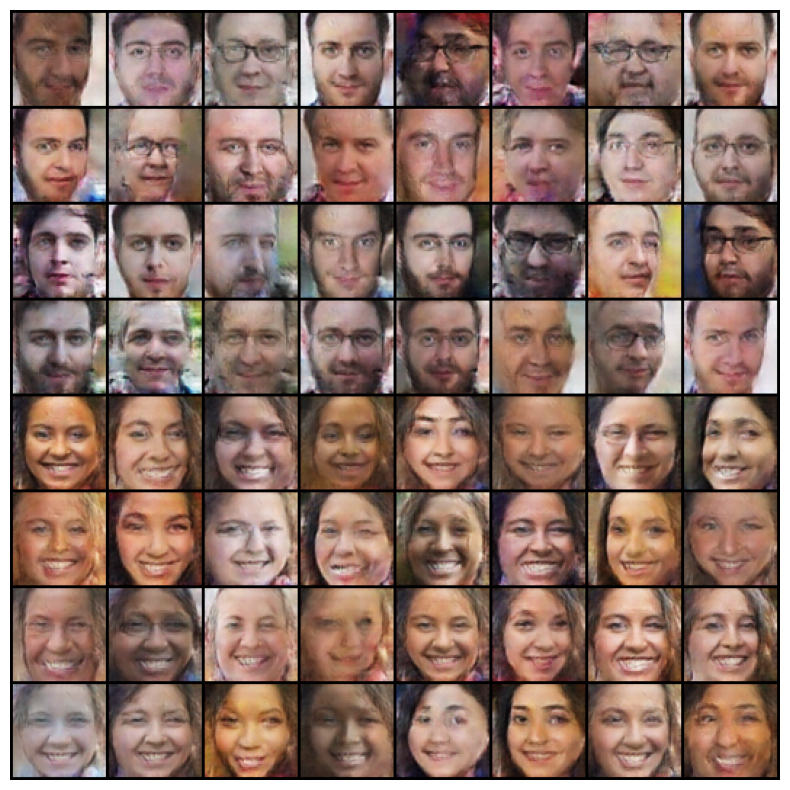

EPOCH: 20.000  d_loss: 0.438  g_loss: 4.755  (802.71s - 200.68s remaining)


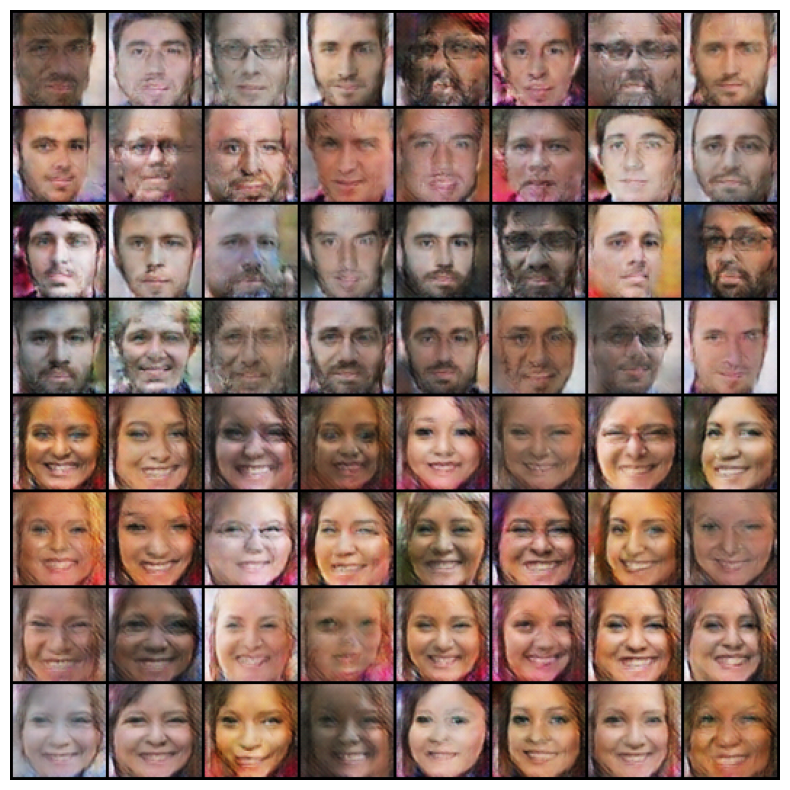

EPOCH: 21.000  d_loss: 0.393  g_loss: 4.676  (842.37s - 160.45s remaining)


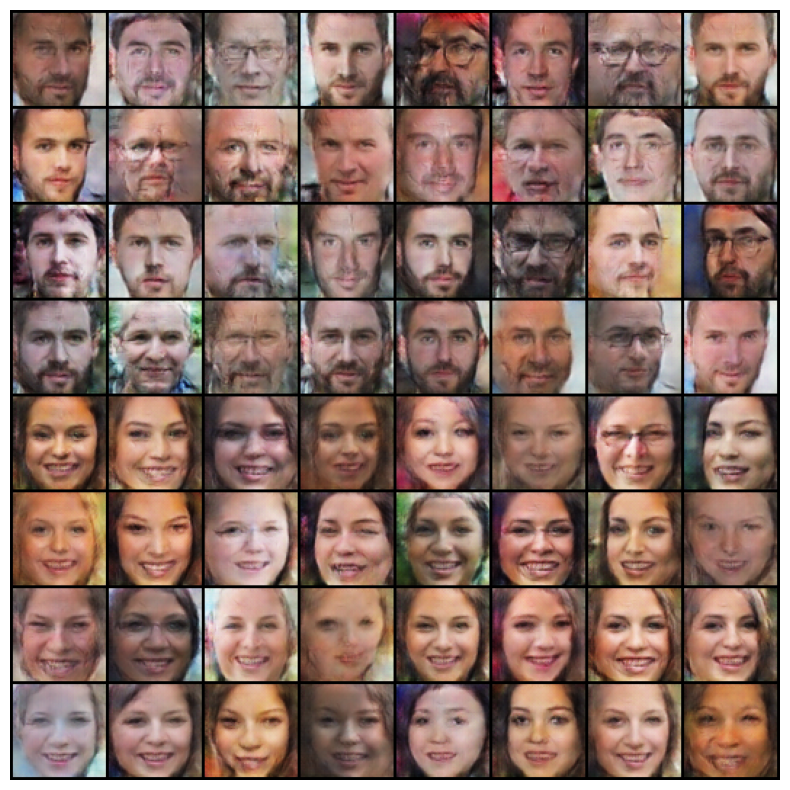

EPOCH: 22.000  d_loss: 0.407  g_loss: 4.734  (882.15s - 120.29s remaining)


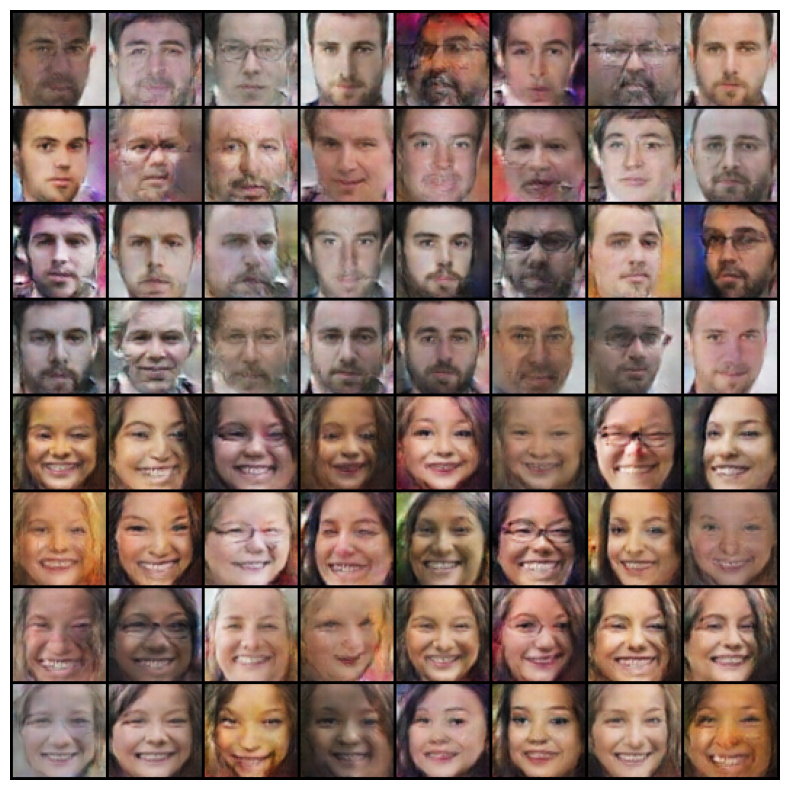

EPOCH: 23.000  d_loss: 0.383  g_loss: 4.764  (921.91s - 80.17s remaining)


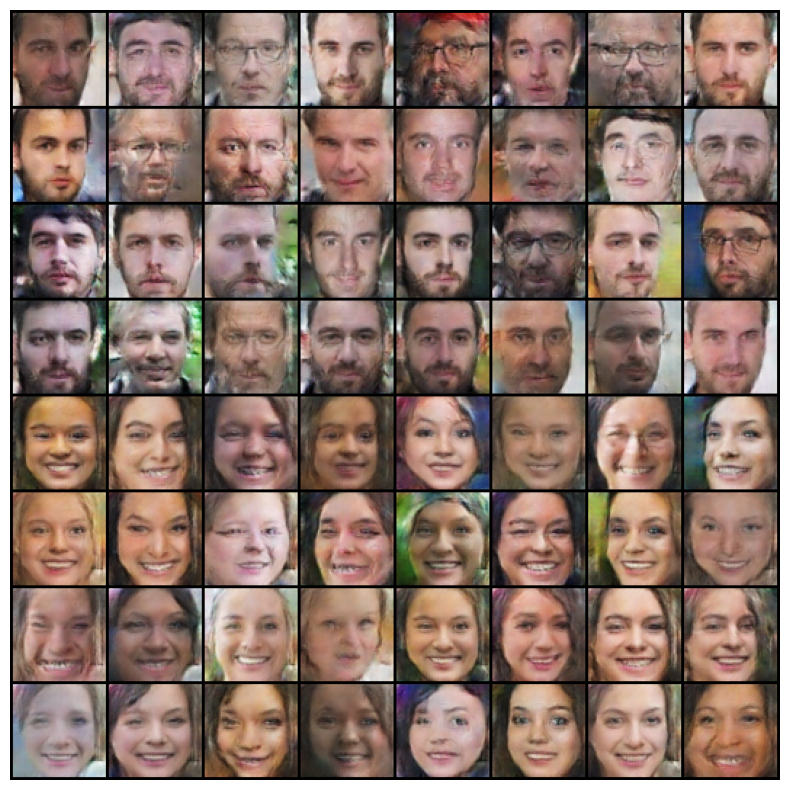

EPOCH: 24.000  d_loss: 0.368  g_loss: 4.735  (961.99s - 40.08s remaining)


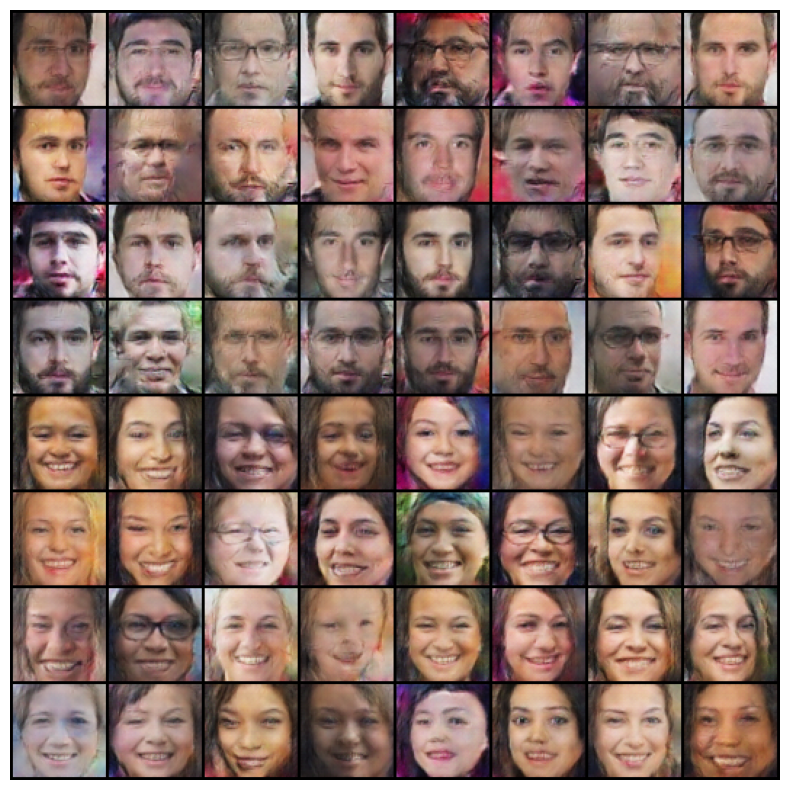

EPOCH: 25.000  d_loss: 0.386  g_loss: 4.880  (1001.43s - 0.00s remaining)


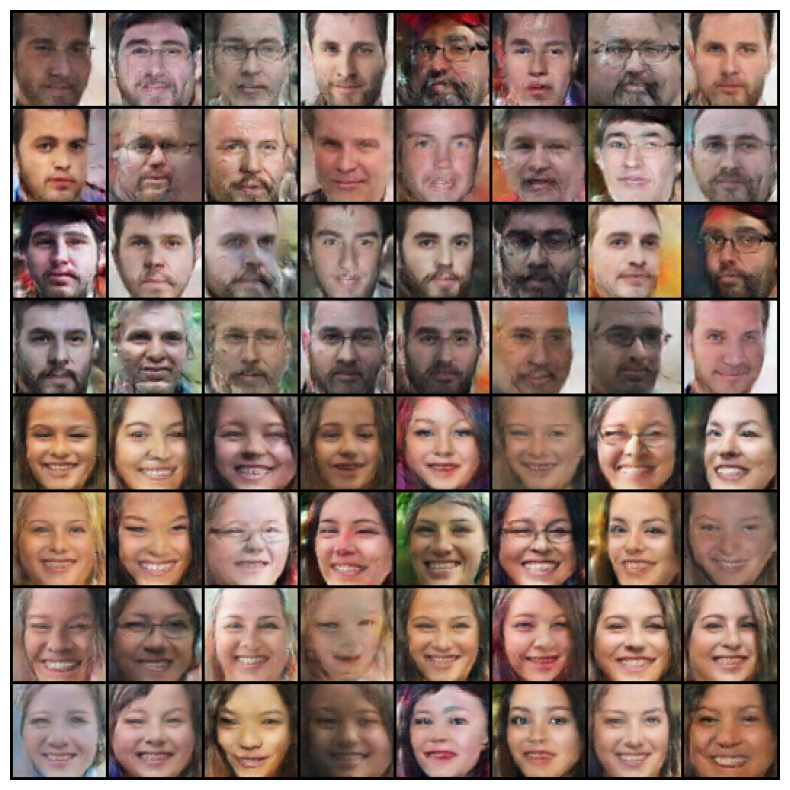

In [20]:
log = Report(n_epochs)
for epoch in range(n_epochs):
    N = len(dataloader)
    for bx, (images, labels) in enumerate(dataloader):
        real_data, real_labels = images.to(device), labels.to(device)
        fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_data))).to(device)
        fake_data = generator(noise(len(real_data)), fake_labels)
        fake_data = fake_data.detach()
        d_loss = discriminator_train_step(real_data, real_labels, fake_data, fake_labels)
        fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_data))).to(device)
        fake_data = generator(noise(len(real_data)), fake_labels).to(device)
        g_loss = generator_train_step(fake_data, fake_labels)
        pos = epoch + (1+bx)/N
        log.record(pos, d_loss=d_loss.detach(), g_loss=g_loss.detach(), end='\r')
    log.report_avgs(epoch+1)
    with torch.no_grad():
        fake = generator(fixed_noise, fixed_fake_labels).detach().cpu()
        imgs = vutils.make_grid(fake, padding=2, normalize=True).permute(1,2,0)
        img_list.append(imgs)
        show(imgs, sz=10)